In [1]:
cd D:\chai_WJH\Neomycin_Project\R

D:\chai_WJH\Neomycin_Project\R


In [2]:
import scanpy as sc
sc.set_figure_params()
adata11 = sc.read_10x_mtx('./filtered_feature_bc_matrix_neo1')
print(adata11)

AnnData object with n_obs × n_vars = 12406 × 32285
    var: 'gene_ids', 'feature_types'


In [3]:
adata11=sc.AnnData(adata11.X,obs=adata11.obs,var=adata11.var)
adata11.var["Gene"]=adata11.var_names
adata11.obs["CellID"]=adata11.obs_names

In [4]:
adata11
adata11.obs_names=['neo1-'+x for x in adata11.obs_names]
adata11.obs_names

Index(['neo1-AAACCCAAGTACCGGA-1', 'neo1-AAACCCAAGTAGCATA-1',
       'neo1-AAACCCACAAGACCTT-1', 'neo1-AAACCCACATACTGTG-1',
       'neo1-AAACCCACATGACGTT-1', 'neo1-AAACCCAGTAGGGAGG-1',
       'neo1-AAACCCAGTCGCATTA-1', 'neo1-AAACCCATCCACAAGT-1',
       'neo1-AAACCCATCCCGTTGT-1', 'neo1-AAACCCATCGCGATCG-1',
       ...
       'neo1-TTTGTTGCAGAGGCTA-1', 'neo1-TTTGTTGCAGCGACCT-1',
       'neo1-TTTGTTGCATACGCAT-1', 'neo1-TTTGTTGGTAAGCGGT-1',
       'neo1-TTTGTTGGTACATTGC-1', 'neo1-TTTGTTGGTATCTCTT-1',
       'neo1-TTTGTTGGTGAGCTCC-1', 'neo1-TTTGTTGTCGAGTGAG-1',
       'neo1-TTTGTTGTCTACGCAA-1', 'neo1-TTTGTTGTCTACGCGG-1'],
      dtype='object', length=12406)

In [5]:
adata11.obs['sample']="neo-1"

In [6]:
import scanpy as sc
sc.set_figure_params()
adata12 = sc.read_10x_mtx('./filtered_feature_bc_matrix_neo2')
print(adata12)

AnnData object with n_obs × n_vars = 13307 × 32285
    var: 'gene_ids', 'feature_types'


In [7]:
adata12=sc.AnnData(adata12.X,obs=adata12.obs,var=adata12.var)
adata12.var["Gene"]=adata12.var_names
adata12.obs["CellID"]=adata12.obs_names

In [8]:
adata12
adata12.obs_names=['neo2-'+x for x in adata12.obs_names]
adata12.obs_names

Index(['neo2-AAACCCAAGAGCCCAA-1', 'neo2-AAACCCAAGCTGCGAA-1',
       'neo2-AAACCCAAGTCGCTAT-1', 'neo2-AAACCCAAGTGTGTTC-1',
       'neo2-AAACCCACAACCTAAC-1', 'neo2-AAACCCACAGAGACTG-1',
       'neo2-AAACCCAGTATAGCTC-1', 'neo2-AAACCCAGTCTTCCGT-1',
       'neo2-AAACCCATCACAATGC-1', 'neo2-AAACCCATCATCACAG-1',
       ...
       'neo2-TTTGTTGAGCCAGTAG-1', 'neo2-TTTGTTGAGTTCGCAT-1',
       'neo2-TTTGTTGCACTTCAGA-1', 'neo2-TTTGTTGCAGGAGGTT-1',
       'neo2-TTTGTTGGTTCAGCTA-1', 'neo2-TTTGTTGTCACGTAGT-1',
       'neo2-TTTGTTGTCCAACCAA-1', 'neo2-TTTGTTGTCGAAACAA-1',
       'neo2-TTTGTTGTCGACATAC-1', 'neo2-TTTGTTGTCGAGTTGT-1'],
      dtype='object', length=13307)

In [9]:
adata12.obs['sample']="neo-2"

In [10]:
adlist=[adata11,adata12]

In [11]:
import scanpy as sc
import pandas as pd
import numpy as np
import anndata as ad
import os
adata1 =ad.concat(adlist,join="outer")

In [12]:
adata1

AnnData object with n_obs × n_vars = 25713 × 32285
    obs: 'CellID', 'sample'

In [13]:
adata1=sc.AnnData(adata1.X,obs=adata1.obs,var=adata1.var)
adata1.var["Gene"]=adata1.var_names
adata1.obs["CellID"]=adata1.obs_names

In [14]:
adata1.obs['batch']='P21_NEO'

In [15]:
adata1.var['mt'] = adata1.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata1, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

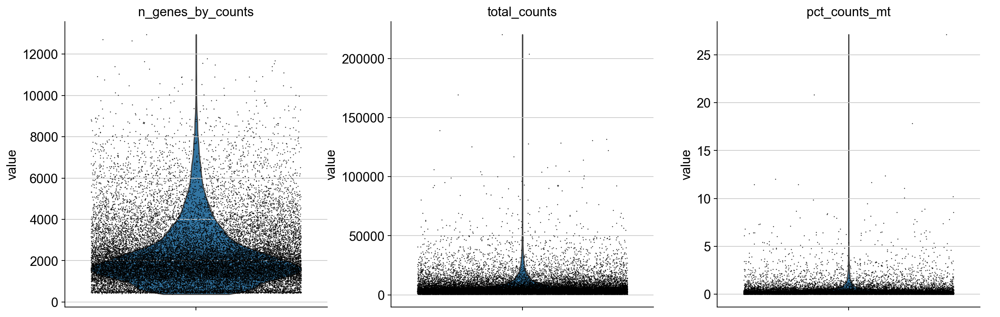

In [16]:
sc.pl.violin(adata1, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

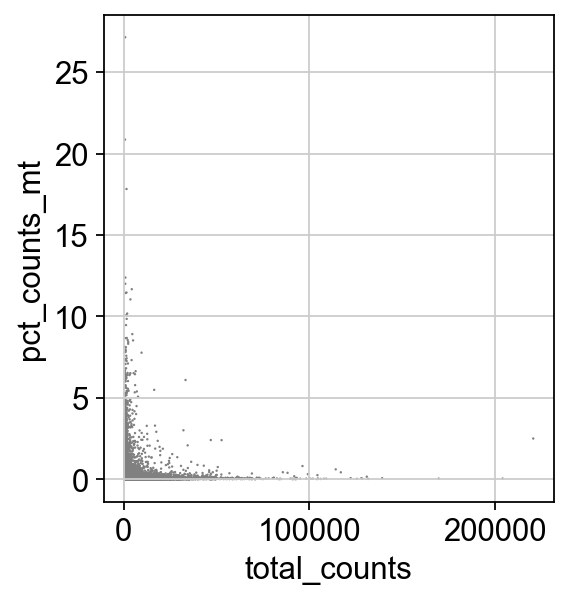

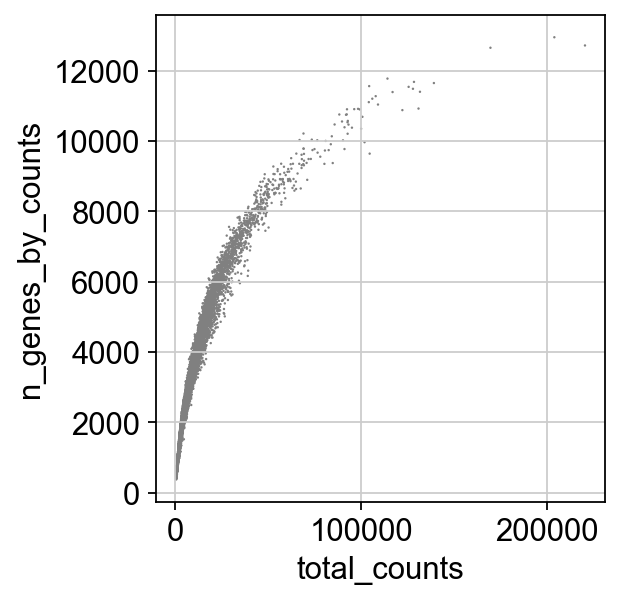

In [17]:
sc.pl.scatter(adata1, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata1, x='total_counts', y='n_genes_by_counts')

In [18]:
adata1 = adata1[adata1.obs.n_genes_by_counts < 5000, :]
adata1 = adata1[adata1.obs.total_counts > 500, :]
adata1 = adata1[adata1.obs.pct_counts_mt < 25, :]
adata1

View of AnnData object with n_obs × n_vars = 24008 × 32285
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [19]:
import scanpy as sc
sc.set_figure_params()
adata21 = sc.read_10x_mtx('./filtered_feature_bc_matrix_ctrl1')
print(adata21)

AnnData object with n_obs × n_vars = 4719 × 32285
    var: 'gene_ids', 'feature_types'


In [20]:
adata21=sc.AnnData(adata21.X,obs=adata21.obs,var=adata21.var)
adata21.var["Gene"]=adata21.var_names
adata21.obs["CellID"]=adata21.obs_names

In [21]:
adata21
adata21.obs_names=['ctr1-'+x for x in adata21.obs_names]
adata21.obs_names

Index(['ctr1-AAACCCACACTGCGAC-1', 'ctr1-AAACCCAGTCCCTGAG-1',
       'ctr1-AAACCCAGTGTCATGT-1', 'ctr1-AAACCCATCACGGTCG-1',
       'ctr1-AAACCCATCATGCATG-1', 'ctr1-AAACGAAAGGTATCTC-1',
       'ctr1-AAACGAACAGGTAGTG-1', 'ctr1-AAACGAAGTAGTTACC-1',
       'ctr1-AAACGAATCTGTAAGC-1', 'ctr1-AAACGCTAGGCAGCTA-1',
       ...
       'ctr1-TTTGGAGTCAGGACAG-1', 'ctr1-TTTGGTTCAAGACCTT-1',
       'ctr1-TTTGGTTTCGACATAC-1', 'ctr1-TTTGGTTTCGAGTGGA-1',
       'ctr1-TTTGGTTTCGATACGT-1', 'ctr1-TTTGGTTTCGCAGTTA-1',
       'ctr1-TTTGGTTTCTCGCGTT-1', 'ctr1-TTTGTTGAGGACTGGT-1',
       'ctr1-TTTGTTGCAATACGAA-1', 'ctr1-TTTGTTGCAGGCCCTA-1'],
      dtype='object', length=4719)

In [22]:
adata21.obs['sample']="ctr-1"

In [23]:
import scanpy as sc
sc.set_figure_params()
adata22 = sc.read_10x_mtx('./filtered_feature_bc_matrix_ctrl2')
print(adata22)

AnnData object with n_obs × n_vars = 4751 × 32285
    var: 'gene_ids', 'feature_types'


In [24]:
adata22=sc.AnnData(adata22.X,obs=adata22.obs,var=adata22.var)
adata22.var["Gene"]=adata22.var_names
adata22.obs["CellID"]=adata22.obs_names

In [25]:
adata22
adata22.obs_names=['ctr2-'+x for x in adata22.obs_names]
adata22.obs_names

Index(['ctr2-AAACCCAAGGCCTGCT-1', 'ctr2-AAACCCAAGTCACGCC-1',
       'ctr2-AAACCCACATGACGTT-1', 'ctr2-AAACCCAGTGCGACAA-1',
       'ctr2-AAACCCAGTGCTTATG-1', 'ctr2-AAACGAAAGTAGTCTC-1',
       'ctr2-AAACGAACAAGATCCT-1', 'ctr2-AAACGAACAGACAATA-1',
       'ctr2-AAACGAAGTGTCCCTT-1', 'ctr2-AAACGAATCATGCCAA-1',
       ...
       'ctr2-TTTGGAGGTTGCTTGA-1', 'ctr2-TTTGGTTAGAACGTGC-1',
       'ctr2-TTTGGTTGTCATCCCT-1', 'ctr2-TTTGGTTGTCCTACGG-1',
       'ctr2-TTTGGTTTCCCTCTTT-1', 'ctr2-TTTGTTGAGAGAGAAC-1',
       'ctr2-TTTGTTGAGCCACCGT-1', 'ctr2-TTTGTTGCAAGGTCAG-1',
       'ctr2-TTTGTTGGTGATGAAT-1', 'ctr2-TTTGTTGTCATCCTAT-1'],
      dtype='object', length=4751)

In [26]:
adata22.obs['sample']="ctr-2"

In [27]:
adlist=[adata21,adata22]

In [28]:
import scanpy as sc
import pandas as pd
import numpy as np
import anndata as ad
import os
adata2 =ad.concat(adlist,join="outer")

In [29]:
adata2=sc.AnnData(adata2.X,obs=adata2.obs,var=adata2.var)
adata2.var["Gene"]=adata2.var_names
adata2.obs["CellID"]=adata2.obs_names

In [30]:
adata2

AnnData object with n_obs × n_vars = 9470 × 32285
    obs: 'CellID', 'sample'
    var: 'Gene'

In [31]:
adata2.obs['batch']='P21_CTR'

In [32]:
adata2.var['mt'] = adata2.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata2, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

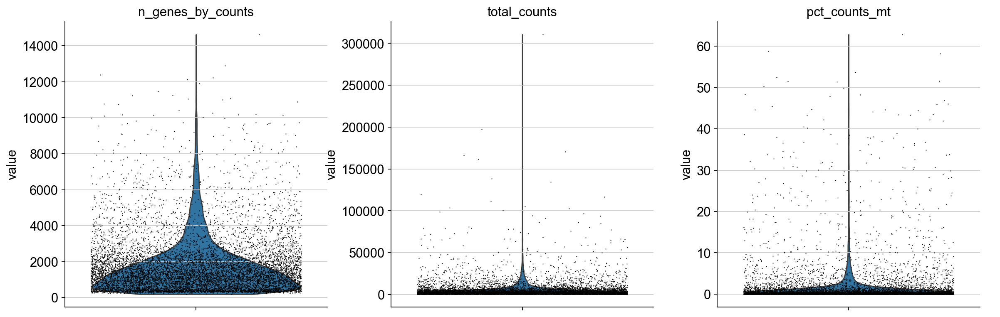

In [33]:
sc.pl.violin(adata2, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

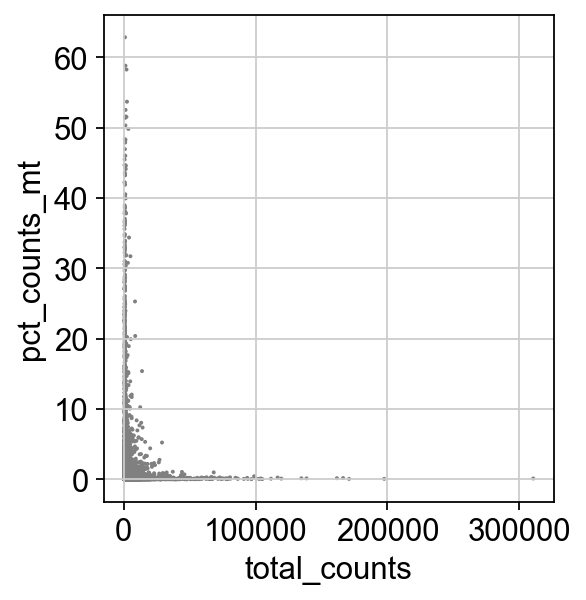

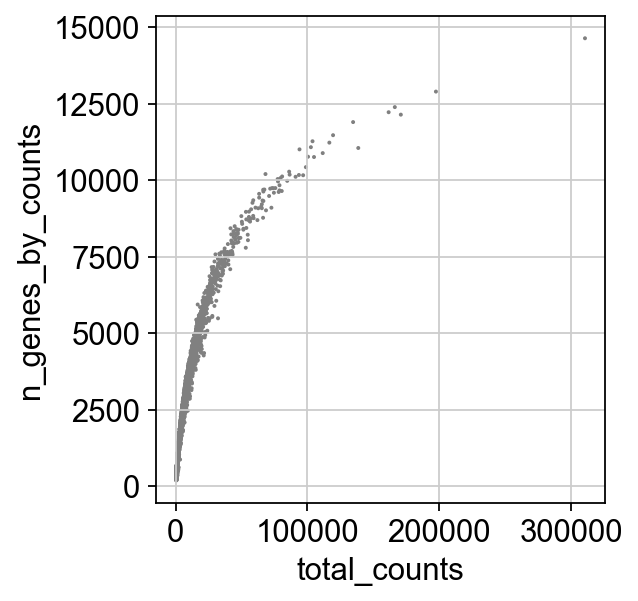

In [34]:
sc.pl.scatter(adata2, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata2, x='total_counts', y='n_genes_by_counts')

In [35]:
adata2 = adata2[adata2.obs.n_genes_by_counts < 5000, :]
adata2 = adata2[adata2.obs.total_counts > 500, :]
adata2 = adata2[adata2.obs.pct_counts_mt < 25, :]
adata2

View of AnnData object with n_obs × n_vars = 8885 × 32285
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [36]:
adata1=adata1.copy()
adata1.layers["counts"] =adata1.X.copy()
adata1

AnnData object with n_obs × n_vars = 24008 × 32285
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    layers: 'counts'

In [37]:
adata2=adata2.copy()
adata2.layers["counts"] =adata2.X.copy()
adata2

AnnData object with n_obs × n_vars = 8885 × 32285
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    layers: 'counts'

In [38]:
adata1.raw = adata1
adata2.raw = adata2

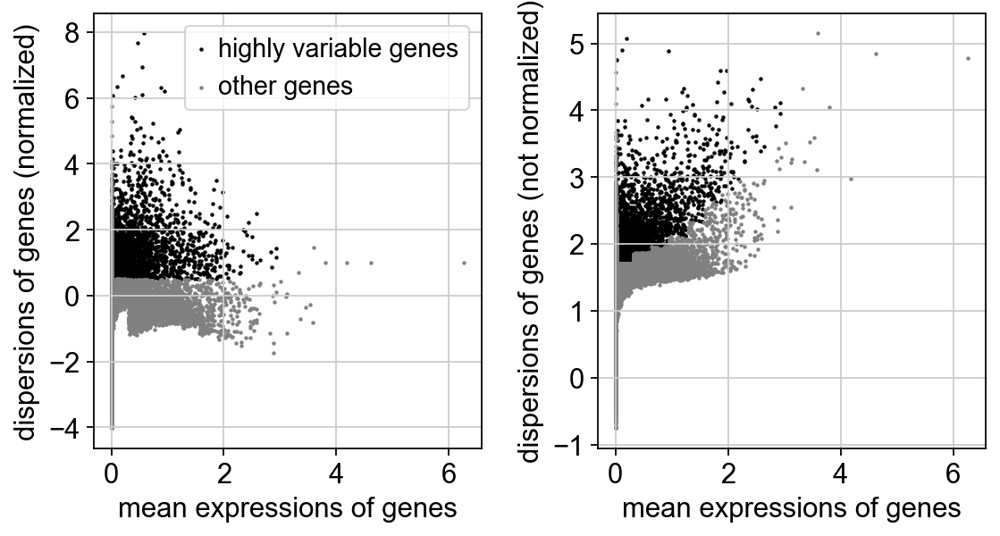

In [39]:
sc.pp.normalize_total(adata1, target_sum=1e4)
sc.pp.log1p(adata1)
sc.pp.highly_variable_genes(adata1, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata1)

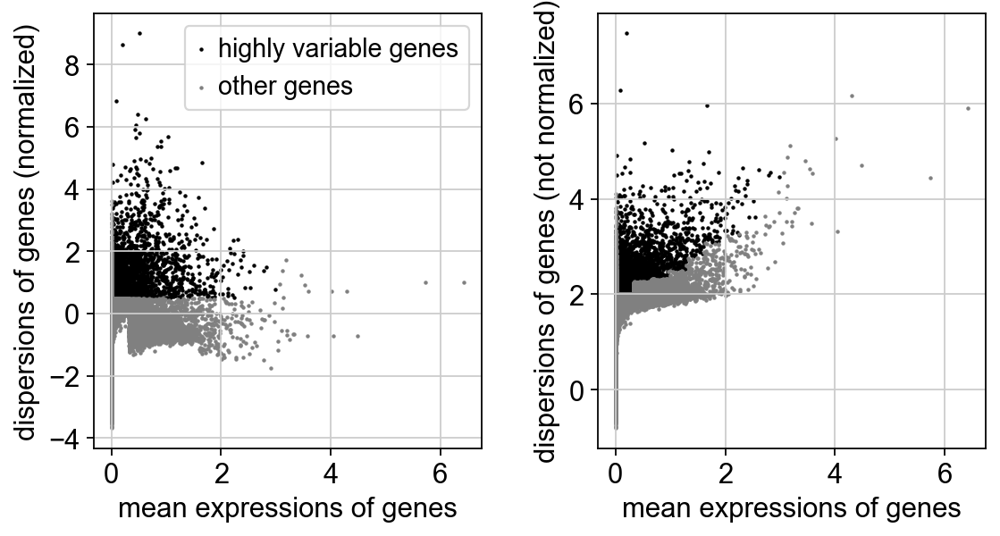

In [40]:
sc.pp.normalize_total(adata2, target_sum=1e4)
sc.pp.log1p(adata2)
sc.pp.highly_variable_genes(adata2, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata2)

In [41]:
adata1 = adata1[:, adata1.var.highly_variable]
adata2 = adata2[:, adata2.var.highly_variable]

In [42]:
adata1

View of AnnData object with n_obs × n_vars = 24008 × 4699
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'
    layers: 'counts'

In [43]:
adata2

View of AnnData object with n_obs × n_vars = 8885 × 5688
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'
    layers: 'counts'

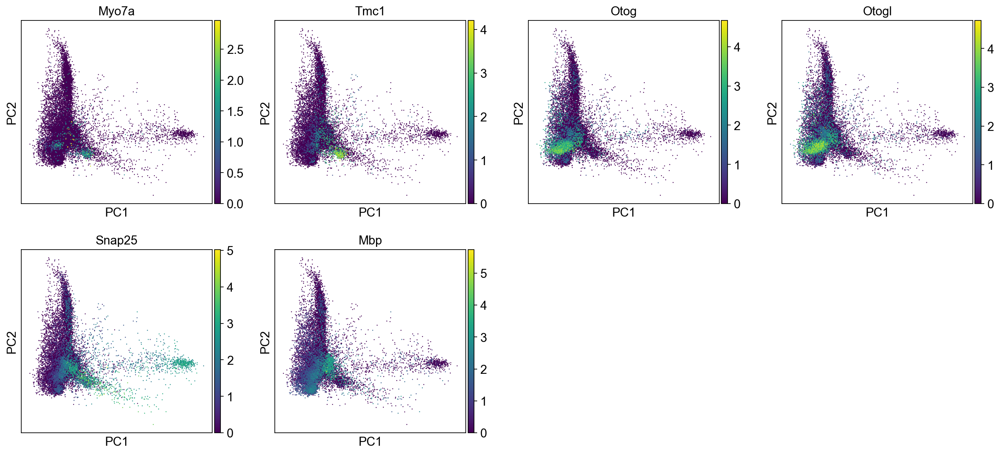

In [44]:
sc.pp.regress_out(adata1, ['total_counts'])
sc.pp.scale(adata1, max_value=10)
sc.tl.pca(adata1, svd_solver='arpack',n_comps=100)
sc.pl.pca(adata1, color=['Myo7a','Tmc1','Otog','Otogl','Snap25','Mbp' ] )

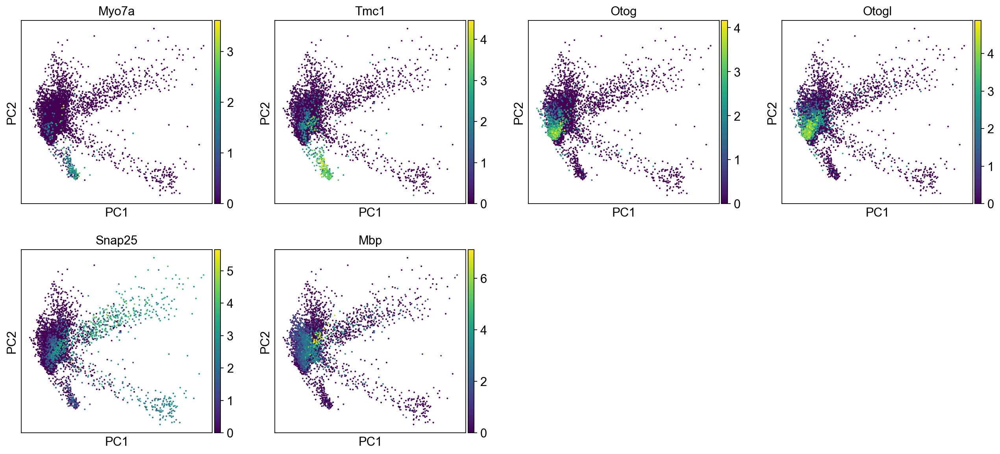

In [45]:
sc.pp.regress_out(adata2, ['total_counts'])
sc.pp.scale(adata2, max_value=10)
sc.tl.pca(adata2, svd_solver='arpack',n_comps=100)
sc.pl.pca(adata2, color=['Myo7a','Tmc1','Otog','Otogl','Snap25','Mbp' ] )

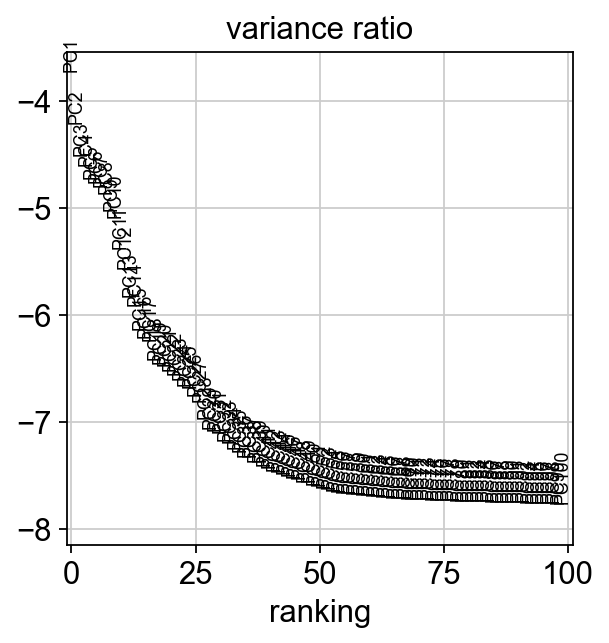

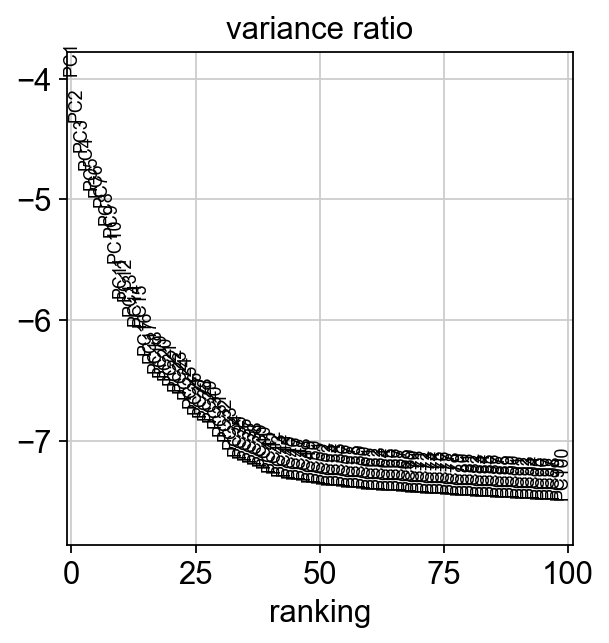

In [46]:
sc.pl.pca_variance_ratio(adata1, log=True,n_pcs=100)
sc.pl.pca_variance_ratio(adata2, log=True,n_pcs=100)

In [47]:
adata1.write("./new_p21/P21_NEO_SCANPY.h5ad")

In [48]:
adata2.write("./new_p21/P21_CTR_SCANPY.h5ad")

In [49]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os
import sys
import scipy
import anndata


plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams["font.family"] = "Arial"

sc.set_figure_params(figsize=(4, 4))
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 600, vector_friendly = True, format = 'pdf')
palette = ['#fbbc04', '#199de5', '#cfe6d5']

In [50]:
def Barplot(which_var, adata, var='clusters', height=3, color = False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var], normalize='index') * 100
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)
    horiz_offset = 1
    vert_offset = 1.
    ax1 = ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset))
#     ax1.figure.savefig(str(sc.settings.figdir)+'/barplot_'+var+'_proportions_'+which_var+'.pdf', bbox_inches='tight',
#                        dpi=300, orientation='landscape', format= 'pdf', optimize=True)

In [51]:
sc.pp.neighbors(adata1, n_neighbors=30, n_pcs=100)
sc.tl.leiden(adata1,resolution=1.2)
sc.tl.louvain(adata1)
sc.tl.umap(adata1)

In [52]:
sc.pp.neighbors(adata2, n_neighbors=30, n_pcs=100)
sc.tl.leiden(adata2,resolution=1.2)
sc.tl.louvain(adata2)
sc.tl.umap(adata2)

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


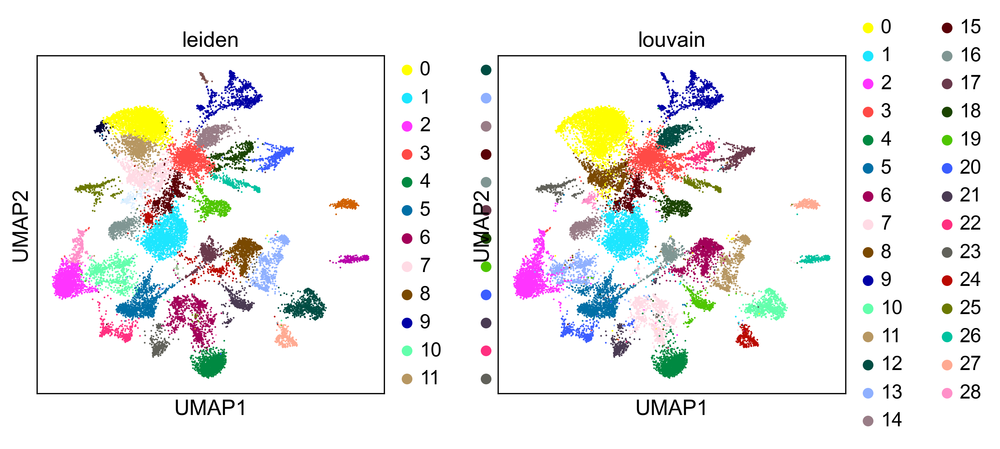

In [53]:
sc.pl.umap(adata1, color=['leiden','louvain'])

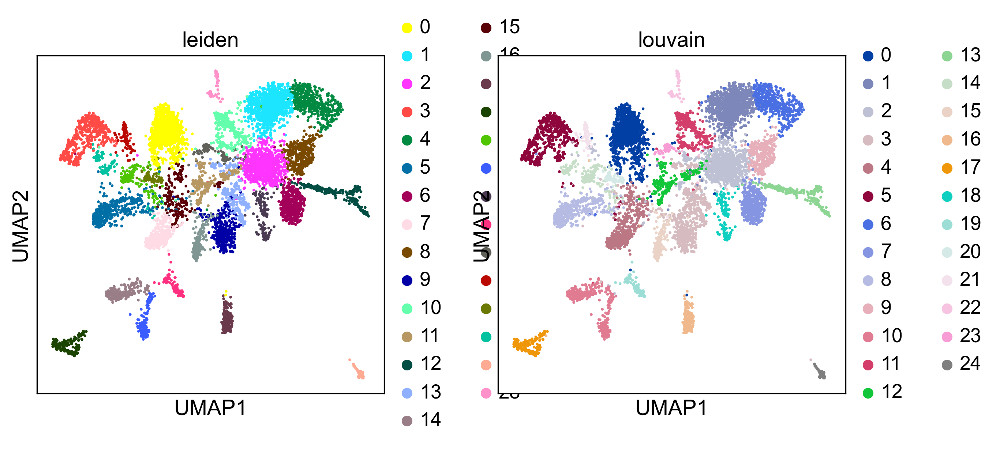

In [54]:
sc.pl.umap(adata2, color=['leiden','louvain'])

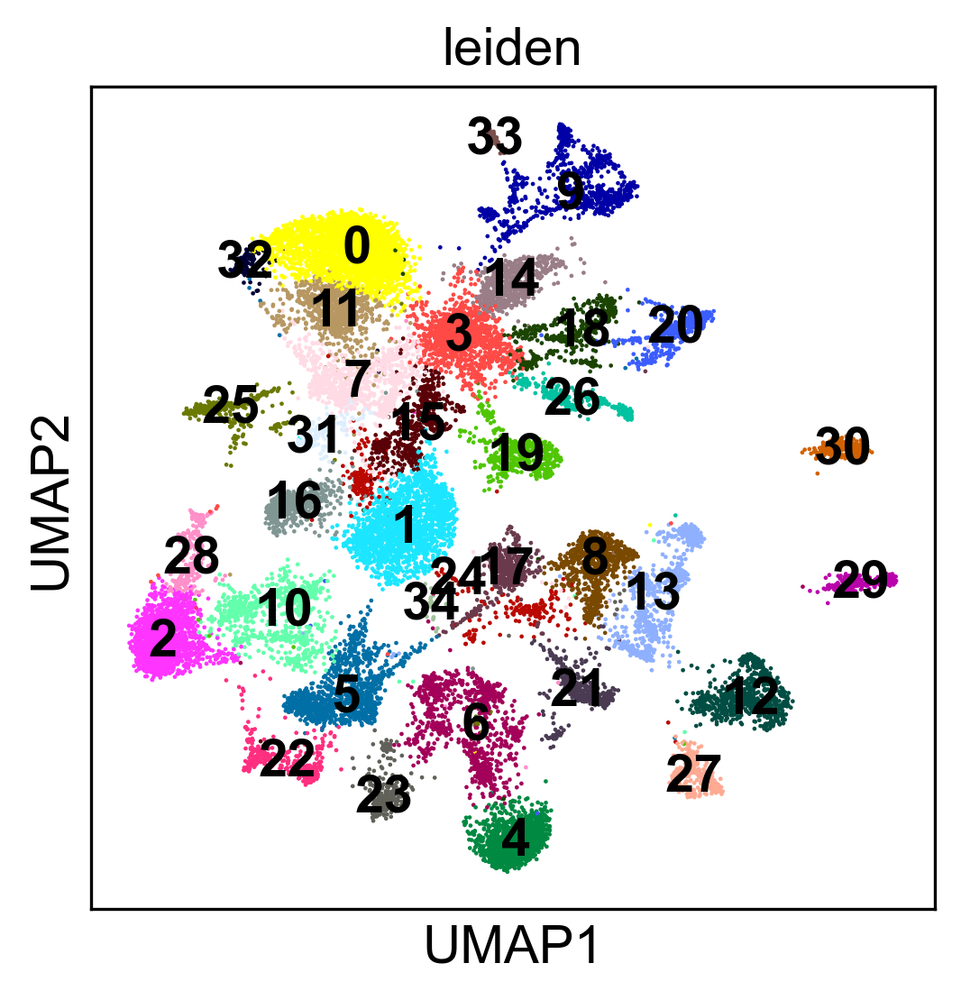

In [55]:
sc.pl.umap(adata1, color=['leiden'],legend_loc="on data")

In [56]:
marker_genes = [
    *["Otoa"], #INTERDENTAL CELLS
    *["Tmc1","Myo7a","Otof","Slc26a5","Slc17a8"],#HAIR CELLS
    *["Otog","Otogl","Ush1c","Gata3","Lgr5"],# SUPPORTING CELLS
    *["Smpx","Lgr6","Enah","Ngfr","Prox1"],#PILLAR CELLS
    *["Prdm12","Fgfr3"],#PILLAR CELLS, DEITERS' CELLS
    *["Ceacam16","Rbp7","Fabp3","S100a1"],#DEITERS' CELLS
    *["Aqp4","Tectb","Slc1a3","Apoe"],#INNER BOR.-PH./HENSEN'S CELLS
    *["Epyc"],#INNER BOR.-PH./HENSEN'S CELLS; CLAUD./IN.-OUT.SULCUS CELLS 
    *["Emilin2","Notum","Rarres1"], #TYMPANIC BORDER CELLS
    
    *["Snap25","Nefl","Pvalb","Tubb3","Th","Ano2","Prph"],#SGN
    *["Olig1","Olig2"], #GLIAL PRECURSOR CELLS
    *["Mag","Mog","Mobp"],#SATELLITE GLIAL CELLS
    *["Mpz","Prx"], #SCHWANN CELLS
    *["Mlana"], #LW
    *["Vwf"], #ENDO.CELLS
    *["Esam"],#ENDO.CELLS
    *["Rgs5","Itga8","Creb5"],#PERICYTES
    *["Tagln"],#SMOOTH MUSCLE CELLS (ALDN1A2)
    *["Kcne1","Esrrb","Dclk1"],#MARGINAL CELLS
    *["Tyr","Dct"],#INTER.STRIA CELLS
    *["Cldn11","Atp6v0a4","Tjp1"],#BASAL STRIA CELLS
    *["Slc26a4","Anxa1"],#SPINDLE CELLS; ROOT CELLS

    
    *["Otos","Col9a2","Col9a3","Atp2b2","Slc13a3","Slc7a11","Slc4a10","Veph1","Chst9","Thsd4"],#FIBROCYTES
    *["Slc12a2","Gjb2"],# FIBROCYTES SUBTYPES I TO V
    *["Dlx5","Bglap","Phex", "Dmp1","Ibsp"], #OSTEOBLASTS
    *["Osr2","Bmp6","Slc7a11"], # SURROUNDING STRUCTURES
    *["Slc26a7"], #RM
    
    #*["RHD"], #ERYTHROCYTES
    #*["LY6G"], #NEUTROPHILS
    *["Cd19"], # B CELLS
    *["Cd3g"], #T CELLS   
    *["Nkg7"],  #NK CELLS
    *["Cd68"], #MONOCYTES
    *["Aif1","Cd163"],#MACROPHAGES 
    #*["PRSS34"]  #MAST CELLS 

    
]

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


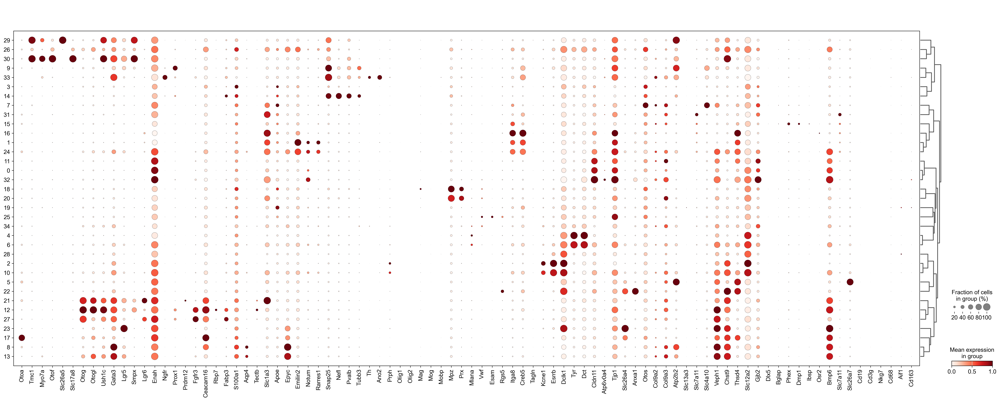

In [57]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata1,groupby='leiden')
sc.pl.dotplot(adata1, marker_genes, groupby="leiden",dendrogram=True, standard_scale="var");

In [58]:
small_marker_dict={
     'HC' :["Tmc1","Slc26a5","Strip2","Pou4f3","Lmo7","Otof","Slc17a8"],
    'IPh_IBC':["Anxa5","Fabp7","Gjb2","Matn4","Prss23"],
    'HeC':["Egfl6","Fst","Nupr1","Pmch"],
    'PC_DC':["Smpx","Lgr6","Enah","Ngfr","Prox1","Prdm12","Fgfr3","Ceacam16","Rbp7","Fabp3","S100a1"],
    'IdC':["Ptgds","Smoc2","Otoa","Fxyd6","Cdkn1c"],
     'TBC':["Emilin2","Slc1a3","Axin2","Tjp1","Atp1a2","Emcn","Coch","Otor","Notum","Rarres1"],
    'SGN':["Snap25","Nefl","Pvalb","Tubb3","Th","Ano2","Prph"],
     'RMC':["Slc4a4","Gpc6","Vmo1","Enah","Krt8","Krt18","Slc26a7"],
    'SWC':["Mpz","Prx"],
    'Glial Cell':["Olig1","Olig2","Mag","Mog","Mobp"],
    'Fibrocytes':["Otos","Col9a2","Col9a3","Atp2b2","Slc13a3","Slc7a11","Slc4a10","Veph1","Chst9","Thsd4"],
    'B Cell':["Cd19"],
    'T Cell':["Cd3g"],
}

categories: 0, 1, 2, etc.
var_group_labels: HC, IPh_IBC, HeC, etc.


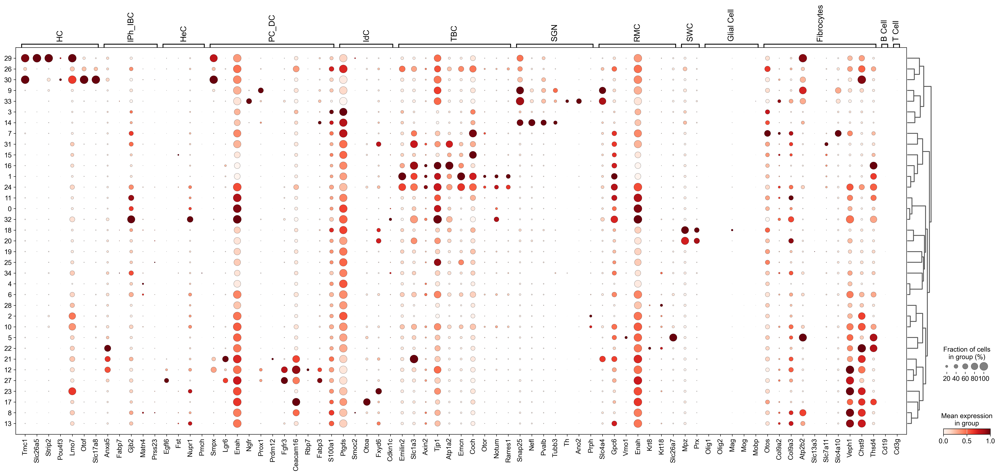

In [59]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata1,
    groupby="leiden",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1

)

In [60]:
#REMOVE 3 19 25 26 28 31 32 34
adata1_sub = adata1[adata1.obs['leiden'].isin(["0","1","2","4","5","6","7","8","9","10","11",
                                               "12","13","14","15","16","17","18","20",
                                               "21","22","23", "24","27","29","30","33"
    
])]

In [61]:
adata1_sub

View of AnnData object with n_obs × n_vars = 20795 × 4699
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [62]:
adata1_sub.layers["scaled"]=sc.pp.scale(adata1_sub.X,max_value=10,copy=True)
adata1_sub.obsm["X_pca"]=sc.pp.pca(adata1_sub[:,adata1_sub.var.highly_variable].layers["scaled"])
sc.pp.neighbors(adata1_sub,n_neighbors=30,n_pcs=50,metric="cosine")
sc.tl.umap(adata1_sub)
sc.tl.leiden(adata1_sub,resolution=1.4,key_added='cluster2')

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


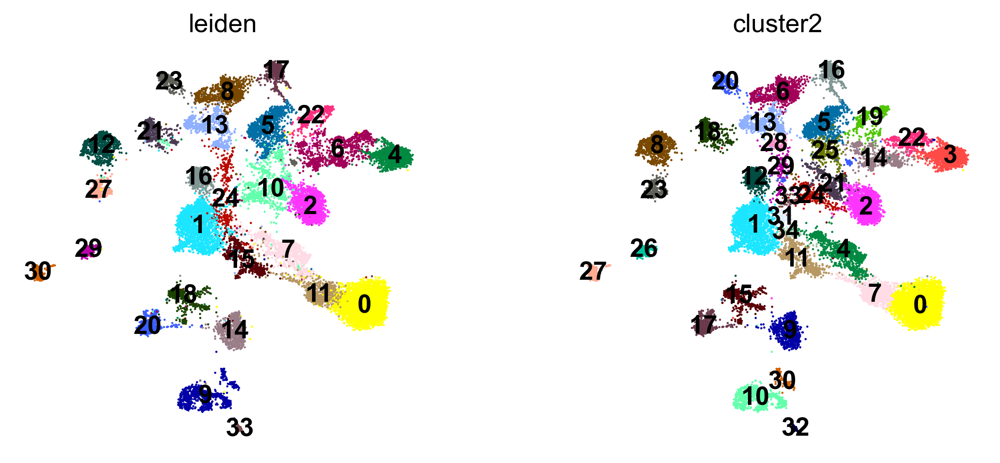

In [63]:
sc.pl.umap(adata1_sub,color=["leiden",'cluster2'],legend_loc="on data")

In [64]:
sc.tl.dendrogram(adata1_sub,groupby="cluster2")

categories: 0, 1, 2, etc.
var_group_labels: HC, IPh_IBC, HeC, etc.


C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


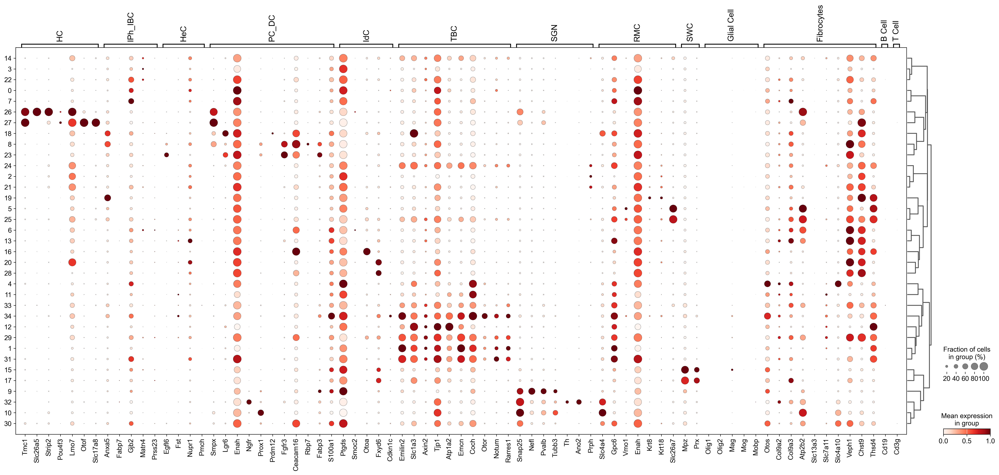

In [65]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata1_sub,
    groupby="cluster2",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     )

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


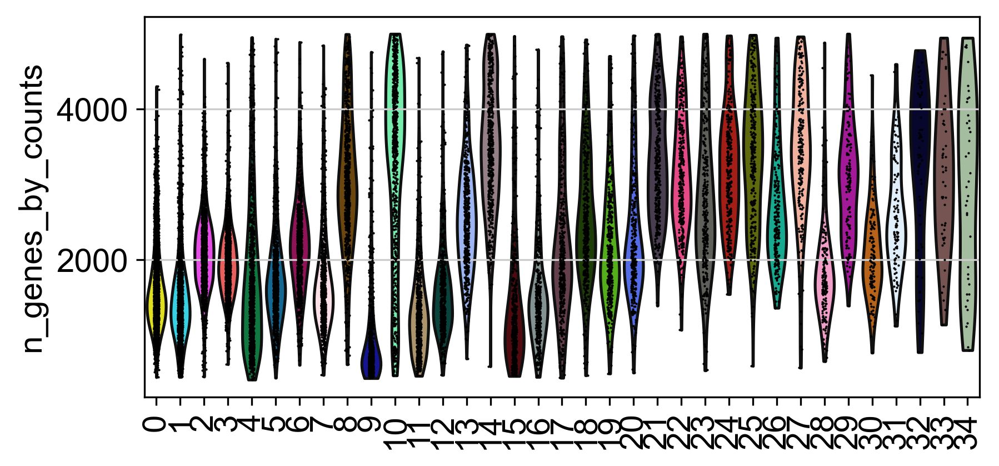

In [66]:
sc.set_figure_params(figsize=(6,3),frameon=False,dpi=150,dpi_save=600)
sc.pl.violin(adata1_sub, ['n_genes_by_counts'], groupby='cluster2',rotation=90)

In [67]:
#REMOVE 11 28 29 30 33 34
adata1_sub = adata1_sub[adata1_sub.obs['cluster2'].isin(["0","1","2","3","4","5","6","7","8","9","10",
                                               "12","13","14","15","16","17","18","19","20",
                                               "21","22","23", "24","25","26","27","31","32"
    
])]

In [68]:
adata1_sub

View of AnnData object with n_obs × n_vars = 19667 × 4699
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster2'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden', 'cluster2_colors', 'dendrogram_cluster2'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'scaled'
    obsp: 'distances', 'connectivities'

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


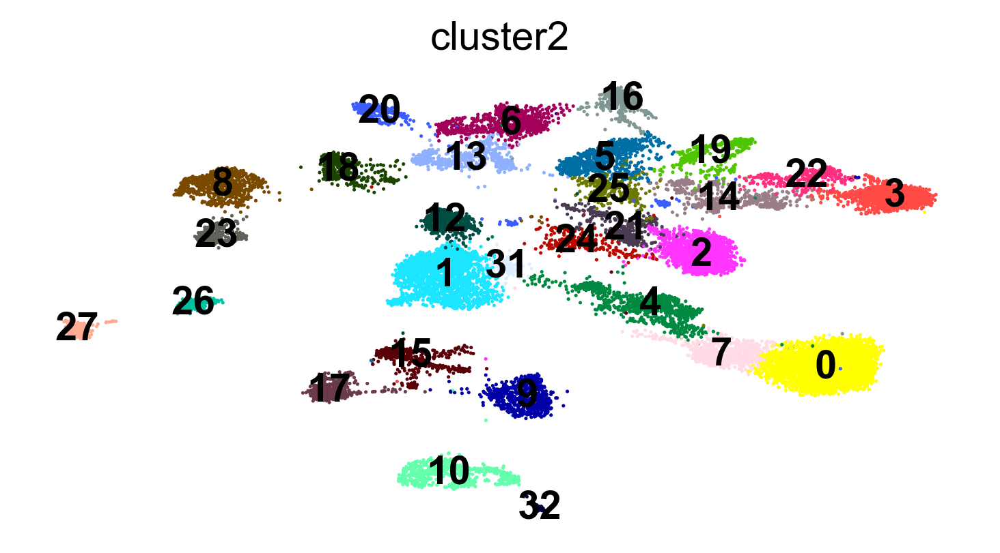

In [69]:
sc.pl.umap(adata1_sub,color=['cluster2'],legend_loc="on data")

In [70]:
cluster_annotation = {
    '0': 'Bs',
    '1': 'TBC',
    '2': 'MC',
    '3': 'Is',
    '4': 'Fb',
    '5': 'RMC',
    '6': 'IBC_IPh_HeC',
    '7': 'Bs',
    '8': 'DC_PC',
    '9': 'TypeI_SGN',
    '10': 'TypeI_SGN',
    '12': 'Pericytes',
    '13': 'IBC_IPh_HeC',
    '14': 'Is',
    '15': 'Schwann.Cells',
    '16': 'IDC',
    '17': 'Schwann.Cells',
    '18': 'DC_PC',
    '19': 'Sp/Rt',
    '20': 'Sp/Rt',
    '21': 'MC',
    '22': 'Is',
    '23': 'DC_PC',
    '24': 'MC',
    '25': 'RMC',
    '26': 'OHC',
    '27': 'IHC',
    '31': 'TBC',
    '32': 'TypeII_SGN',
}
adata1_sub.obs['cell_type2'] = adata1_sub.obs['cluster2'].map(cluster_annotation).astype('category')

C:\Users\DELL\AppData\Local\Temp\ipykernel_29252\2630843264.py:32: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata1_sub.obs['cell_type2'] = adata1_sub.obs['cluster2'].map(cluster_annotation).astype('category')


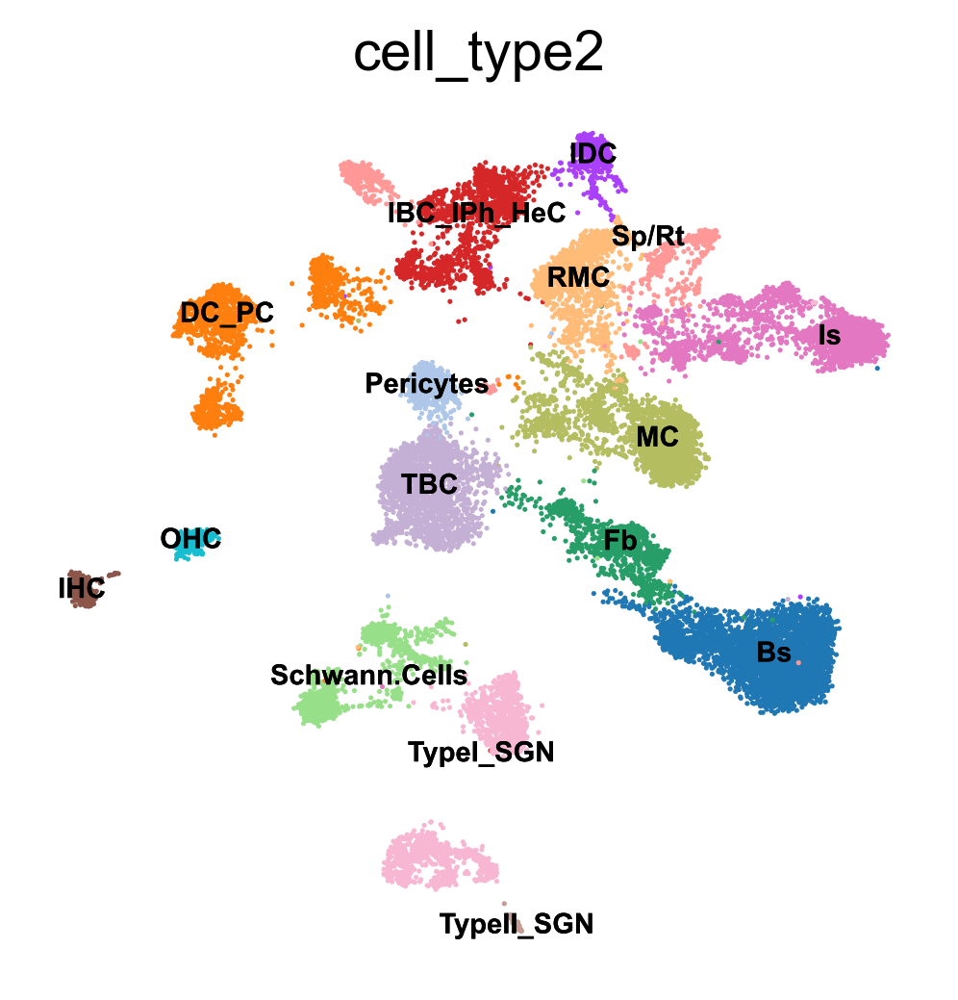

In [71]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata1_sub,color='cell_type2',legend_loc='on data',frameon=False, legend_fontsize=7, legend_fontoutline=False
         )

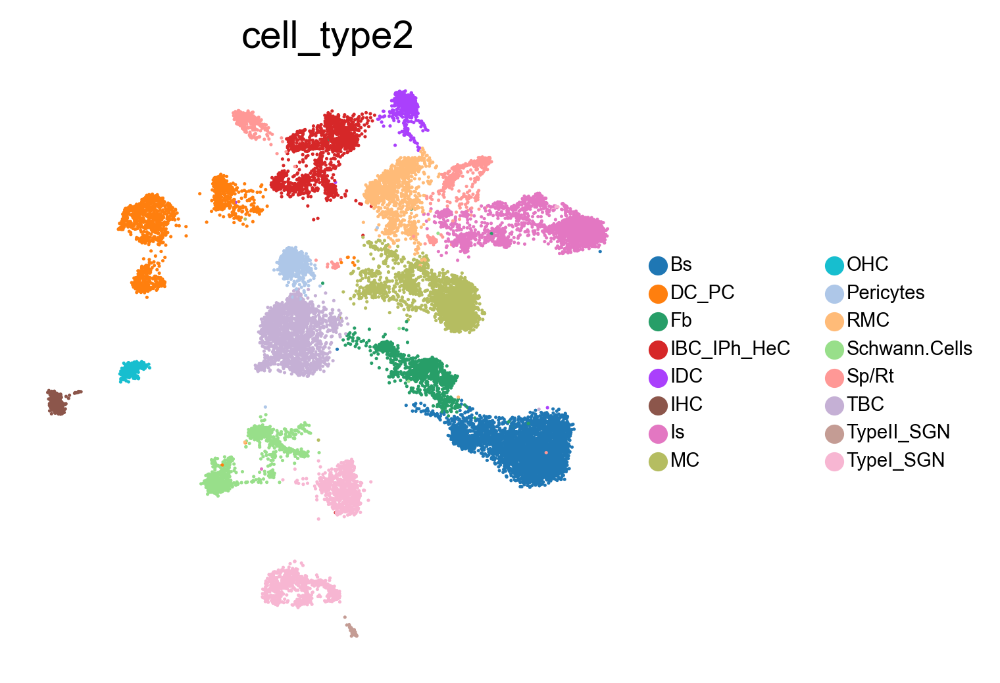

In [72]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata1_sub,color='cell_type2',frameon=False, legend_fontsize=7, legend_fontoutline=False,
         )

In [73]:
small_marker_dict={
    'OHC':["Slc26a5"],
    'IHC' :["Otof","Myo7a","Slc17a8"],
    'IBC_IPh_HeC':["Aqp4","Epyc"],
    'DC_PC':["Lgr6","Fgfr3","Ceacam16"],
    'TBC':["Emilin2","Axin2","Tjp1","Emcn","Notum","Rarres1"],
     'IDC':["Otoa"],
    'Is':["Tyr","Dct"],
     'Bs':["Cldn11","Tjp1"],
    'Schwann.Cells':["Mpz","Prx"],
    'TypeI_SGN':["Snap25","Nefl","Pvalb","Tubb3"],
    'TypeII_SGN':["Th","Ano2"],
    'Fb':["Otos","Col9a2","Col9a3","Slc4a10"],
    'RMC':["Slc26a7"],
    'Sp/Rt':["Slc26a4","Anxa1"],
    'Pericytes':["Itga8","Creb5"],    
    'MC':["Kcne1","Esrrb","Dclk1"],
}

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


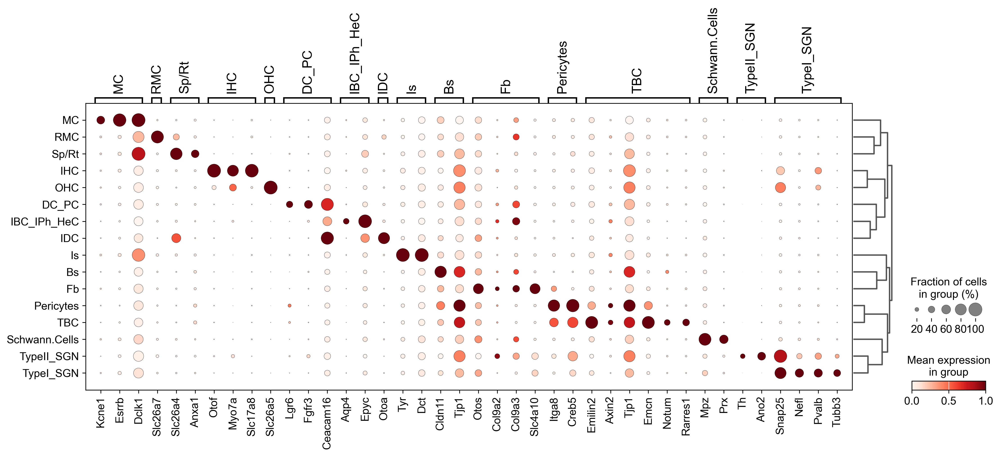

In [74]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata1_sub,
    groupby="cell_type2",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
)

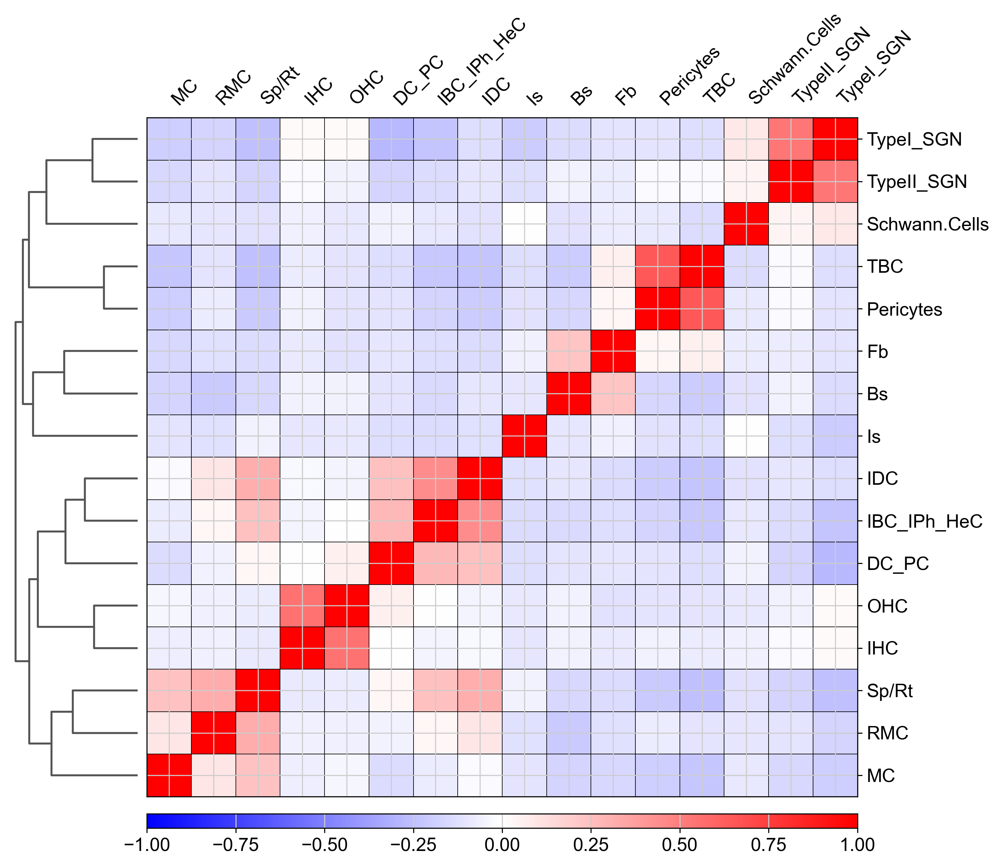

In [75]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.correlation_matrix(adata1_sub, 'cell_type2')

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


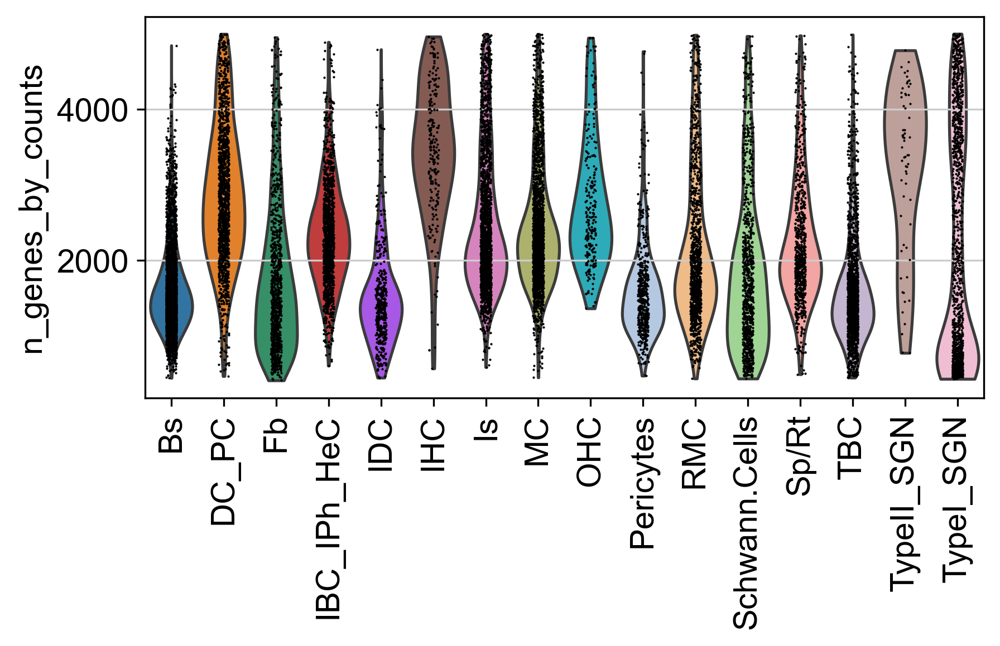

In [76]:
sc.set_figure_params(figsize=(6,3),frameon=False,dpi=150,dpi_save=600)
sc.pl.violin(adata1_sub, ['n_genes_by_counts'], groupby='cell_type2',rotation=90)

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


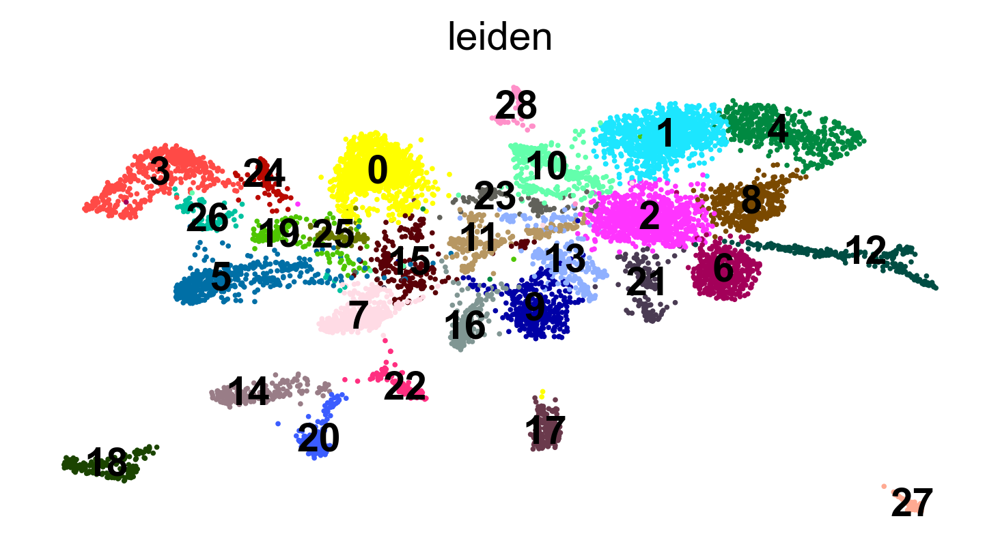

In [77]:
sc.pl.umap(adata2, color=['leiden'],legend_loc="on data")

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


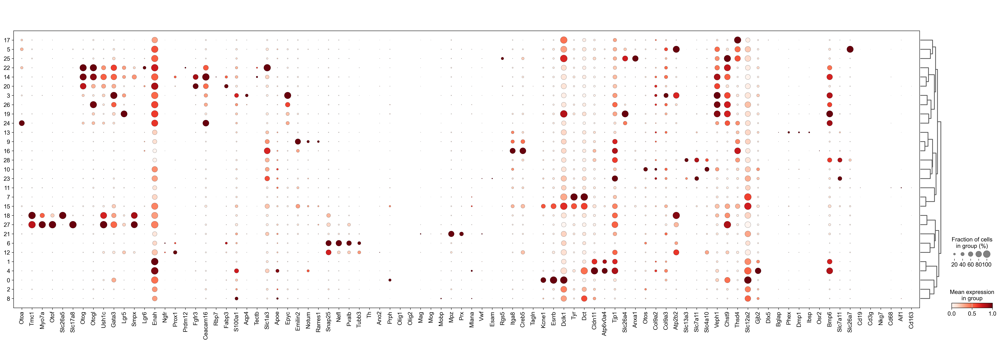

In [78]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata2,groupby='leiden')
sc.pl.dotplot(adata2, marker_genes, groupby="leiden",dendrogram=True, standard_scale="var");

categories: 0, 1, 2, etc.
var_group_labels: OHC, IHC, IBC_IPh_HeC, etc.


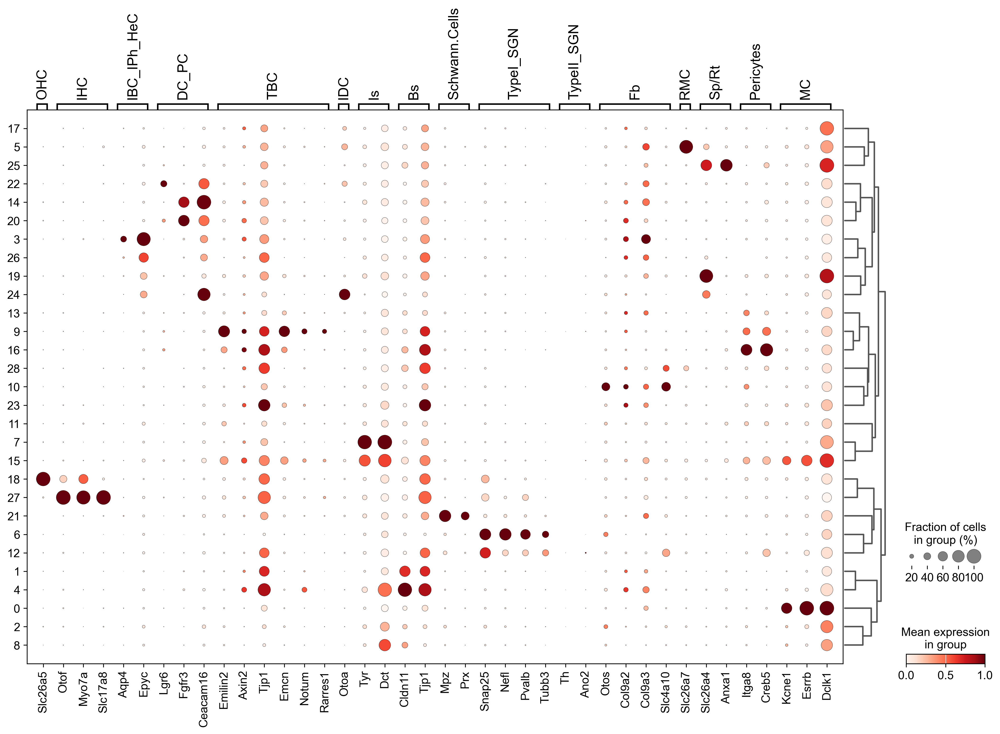

In [79]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata2,
    groupby="leiden",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
)

In [80]:
#REMOVE 2 8 11 13 15 17 23
adata2_sub = adata2[adata2.obs['leiden'].isin(["0","1","3","4","5","6","7","9","10",
                                               "12","14","16","18","19","20",
                                               "21","22","24","25","26","27","28"
    
])]

In [81]:
adata2_sub

View of AnnData object with n_obs × n_vars = 6656 × 5688
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

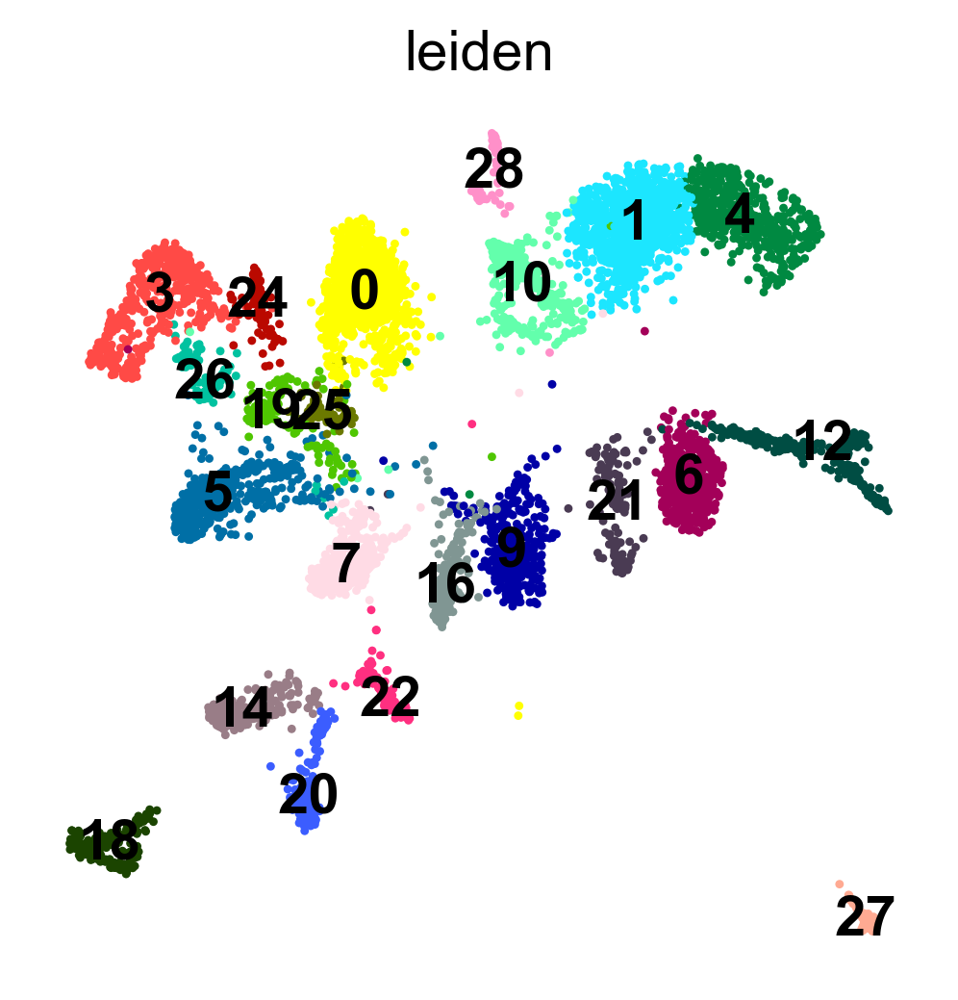

In [82]:
sc.pl.umap(adata2_sub, color=['leiden'],legend_loc="on data")

In [83]:
adata2_sub.obs["cluster"]=adata2_sub.obs["leiden"]

C:\Users\DELL\AppData\Local\Temp\ipykernel_29252\384029074.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata2_sub.obs["cluster"]=adata2_sub.obs["leiden"]


In [84]:
adata2_sub.layers["scaled"]=sc.pp.scale(adata2_sub.X,max_value=10,copy=True)
adata2_sub.obsm["X_pca"]=sc.pp.pca(adata2_sub[:,adata2_sub.var.highly_variable].layers["scaled"])
sc.pp.neighbors(adata2_sub,n_neighbors=30,n_pcs=50,metric="cosine")
sc.tl.umap(adata2_sub)
sc.tl.leiden(adata2_sub,resolution=1.4,key_added='cluster2')

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


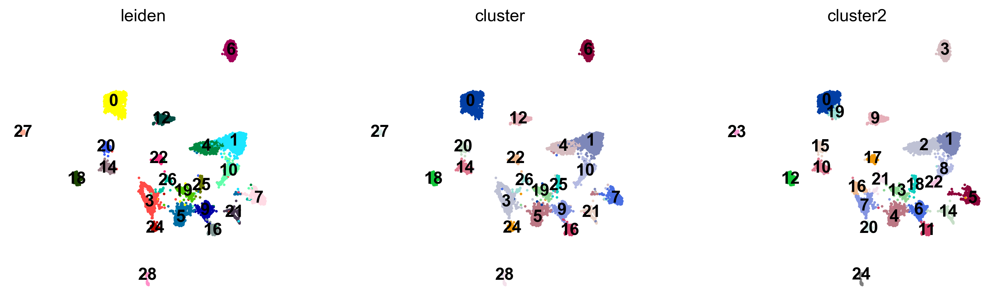

In [85]:
sc.pl.umap(adata2_sub,color=["leiden","cluster",'cluster2'],legend_loc="on data")

categories: 0, 1, 2, etc.
var_group_labels: OHC, IHC, IBC_IPh_HeC, etc.


C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


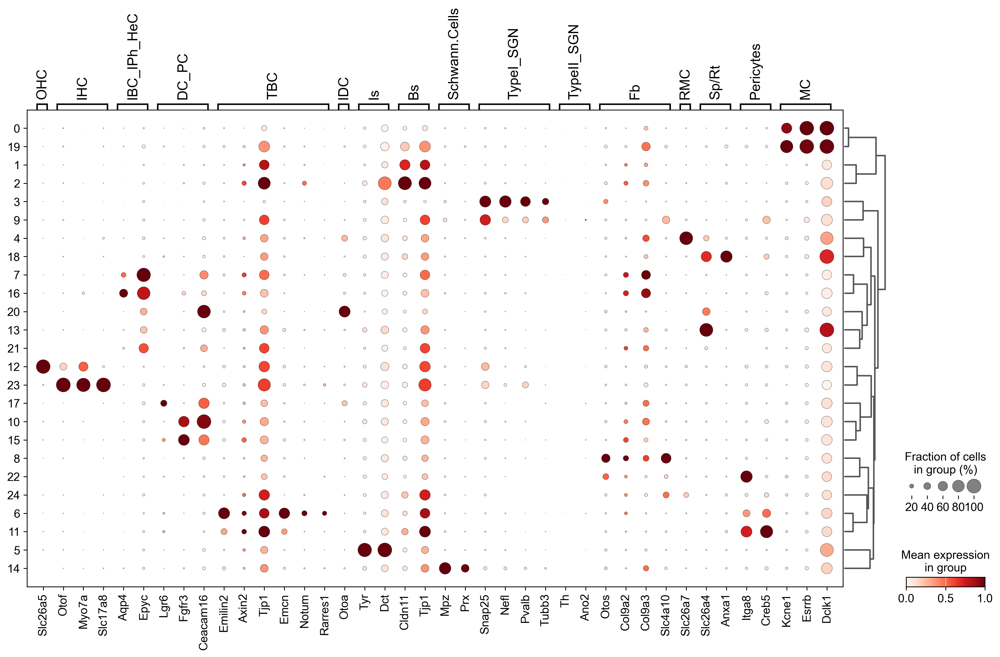

In [86]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata2_sub,
    groupby="cluster2",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     )

In [87]:
#REMOVE 24
adata2_sub = adata2_sub[adata2_sub.obs['cluster2'].isin(["0","1","2","3","4","5","6","7","8","9","10","11",
                                               "12","13","14","15","16","17","18","19","20",
                                               "21","22","23"
    
])]

In [88]:
adata2_sub

View of AnnData object with n_obs × n_vars = 6598 × 5688
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster', 'cluster2'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden', 'cluster_colors', 'cluster2_colors', 'dendrogram_cluster2'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'scaled'
    obsp: 'distances', 'connectivities'

In [89]:
cluster_annotation = {
    '0': 'MC',
    '1': 'Bs',
    '2': 'Bs',
    '3': 'TypeI_SGN',
    '4': 'RMC',
    '5': 'Is',
    '6': 'TBC',
    '7': 'IBC_IPh_HeC',
    '8': 'Fb',
    '9': 'TypeII_SGN',
    '10': 'DC_PC',
    '11':'Pericytes',
    '12': 'OHC',
    '13': 'Sp/Rt',
    '14': 'Schwann.Cells',
    '15': 'DC_PC',
    '16': 'IBC_IPh_HeC',
    '17': 'DC_PC',
    '18': 'Sp/Rt',
    '19': 'MC',
    '20': 'IDC',
    '21': 'IBC_IPh_HeC',
    '22': 'Fb',
    '23': 'IHC',
}
adata2_sub.obs['cell_type2'] = adata2_sub.obs['cluster2'].map(cluster_annotation).astype('category')

C:\Users\DELL\AppData\Local\Temp\ipykernel_29252\3527640518.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata2_sub.obs['cell_type2'] = adata2_sub.obs['cluster2'].map(cluster_annotation).astype('category')


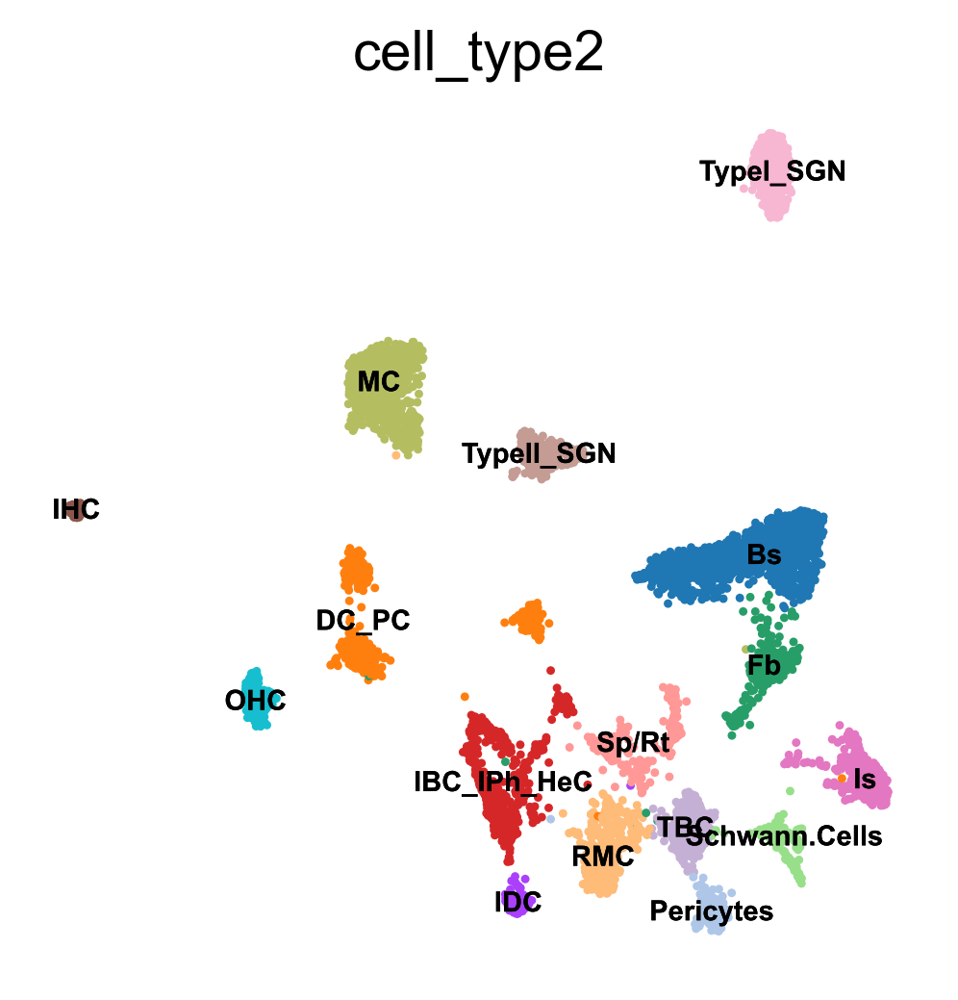

In [90]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata2_sub,color='cell_type2',legend_loc='on data',frameon=False, legend_fontsize=7, legend_fontoutline=False,
          save="Neomycin_p21_ctr_CELL_TYPE_ANNO1.pdf")

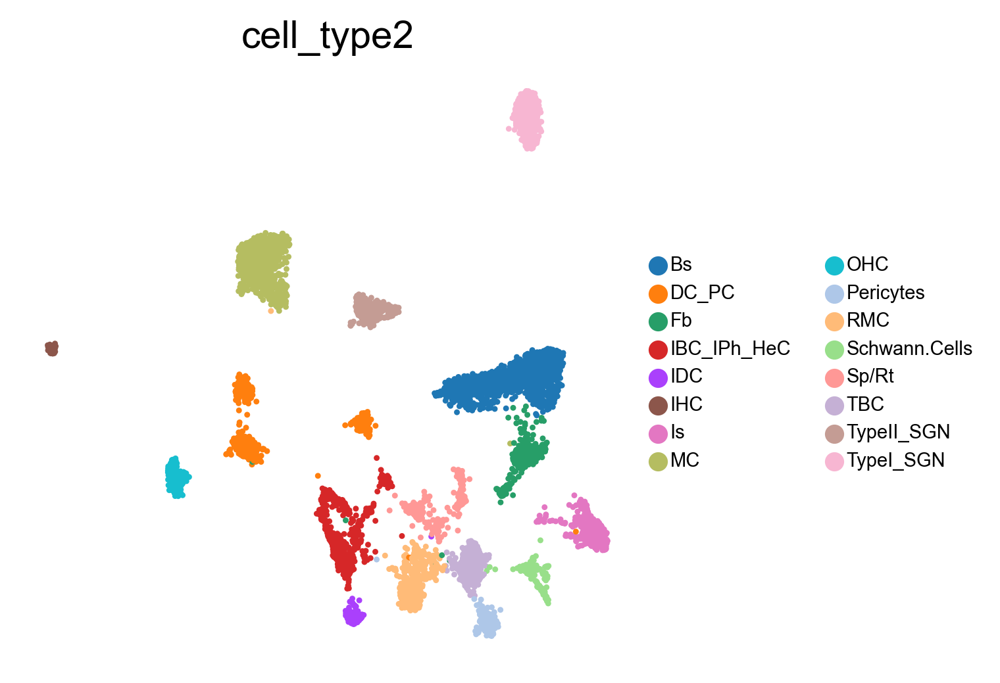

In [91]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata2_sub,color='cell_type2',frameon=False, legend_fontsize=7, legend_fontoutline=False,
          )

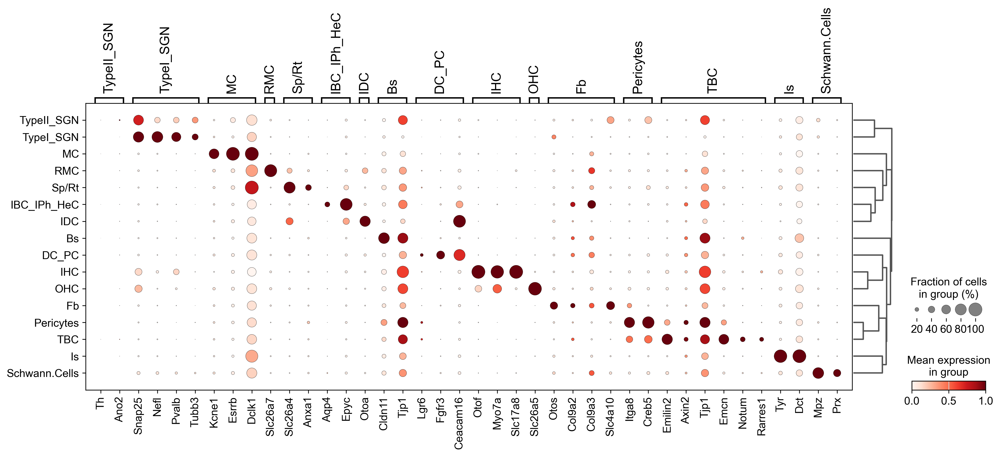

In [92]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata2_sub,
    groupby="cell_type2",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var"  # standard scale: normalize each gene to range from 0 to 1
)

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


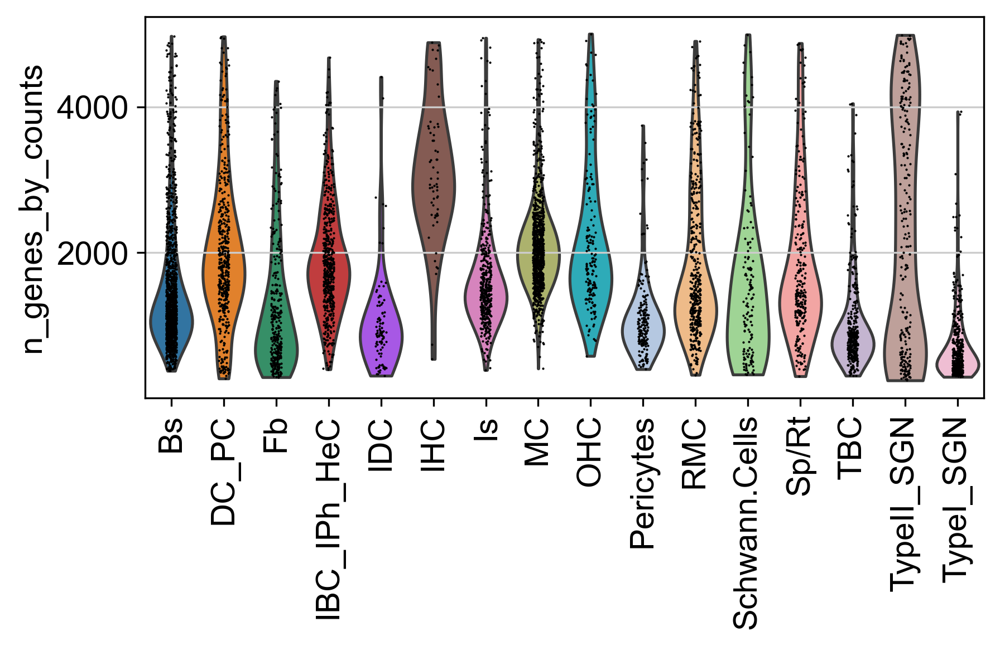

In [93]:
sc.set_figure_params(figsize=(6,3),frameon=False,dpi=150,dpi_save=600)
sc.pl.violin(adata2_sub, ['n_genes_by_counts'], groupby='cell_type2',rotation=90)

In [94]:
adata1_sub.write("./new_p21/P21_NEO_SCANPY_sub.h5ad")

In [95]:
adata2_sub.write("./new_p21/P21_CTR_SCANPY_sub.h5ad")

In [96]:
adata1_raw=adata1_sub.raw.to_adata()
adata1_raw

AnnData object with n_obs × n_vars = 19667 × 32285
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster2', 'cell_type2'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden', 'cluster2_colors', 'dendrogram_cluster2', 'cell_type2_colors', 'dendrogram_cell_type2'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [97]:
adata2_raw=adata2_sub.raw.to_adata()
adata2_raw

AnnData object with n_obs × n_vars = 6598 × 32285
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster', 'cluster2', 'cell_type2'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden', 'cluster_colors', 'cluster2_colors', 'dendrogram_cluster2', 'cell_type2_colors', 'dendrogram_cell_type2'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [98]:
adata1_raw.var_names_make_unique() 
adata2_raw.var_names_make_unique() 

In [99]:
adata1_raw

AnnData object with n_obs × n_vars = 19667 × 32285
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster2', 'cell_type2'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden', 'cluster2_colors', 'dendrogram_cluster2', 'cell_type2_colors', 'dendrogram_cell_type2'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [100]:
adata2_raw

AnnData object with n_obs × n_vars = 6598 × 32285
    obs: 'CellID', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster', 'cluster2', 'cell_type2'
    var: 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden', 'cluster_colors', 'cluster2_colors', 'dendrogram_cluster2', 'cell_type2_colors', 'dendrogram_cell_type2'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


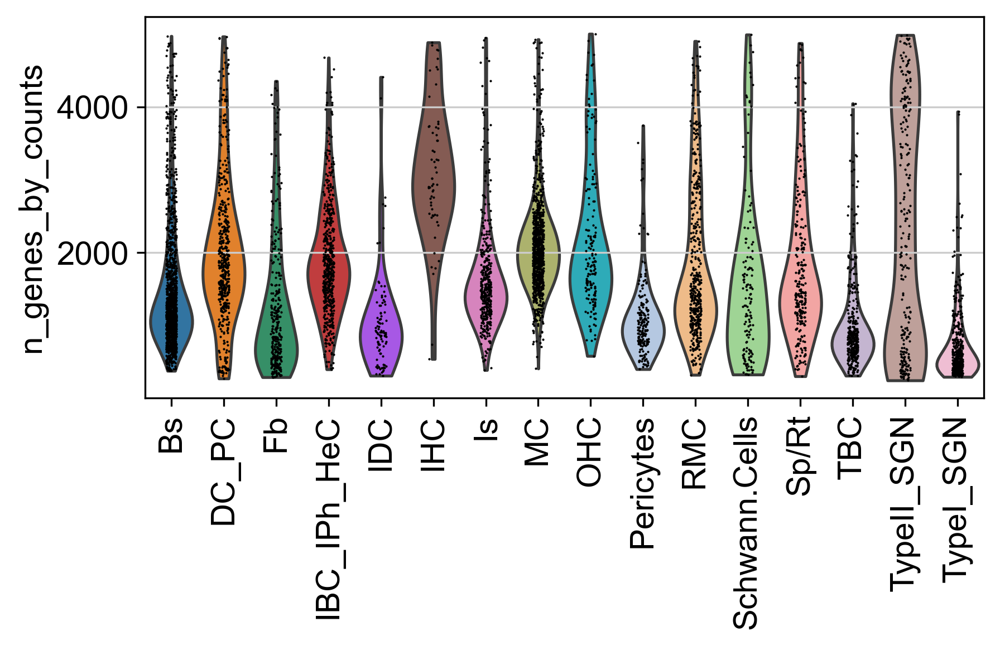

In [101]:
sc.set_figure_params(figsize=(6,3),frameon=False,dpi=150,dpi_save=600)
sc.pl.violin(adata2_raw, ['n_genes_by_counts'], groupby='cell_type2',rotation=90)

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


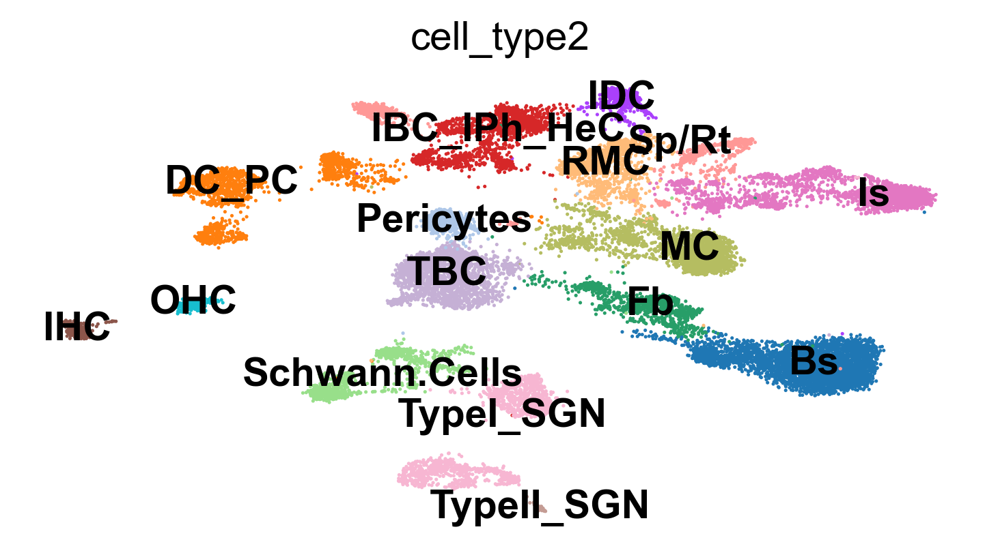

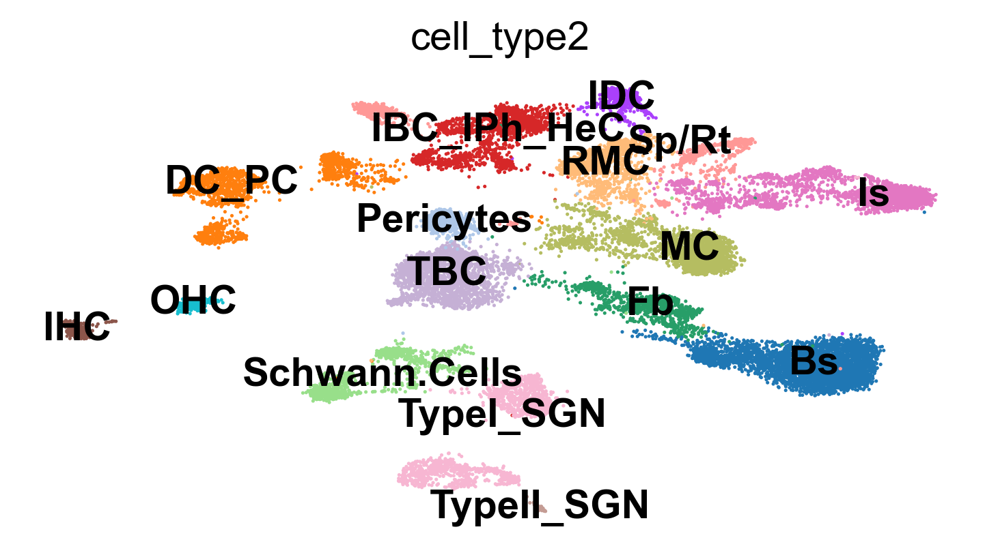

In [102]:
sc.pl.umap(adata1_sub, color=['cell_type2'],legend_loc="on data")
sc.pl.umap(adata1_raw, color=['cell_type2'],legend_loc="on data")

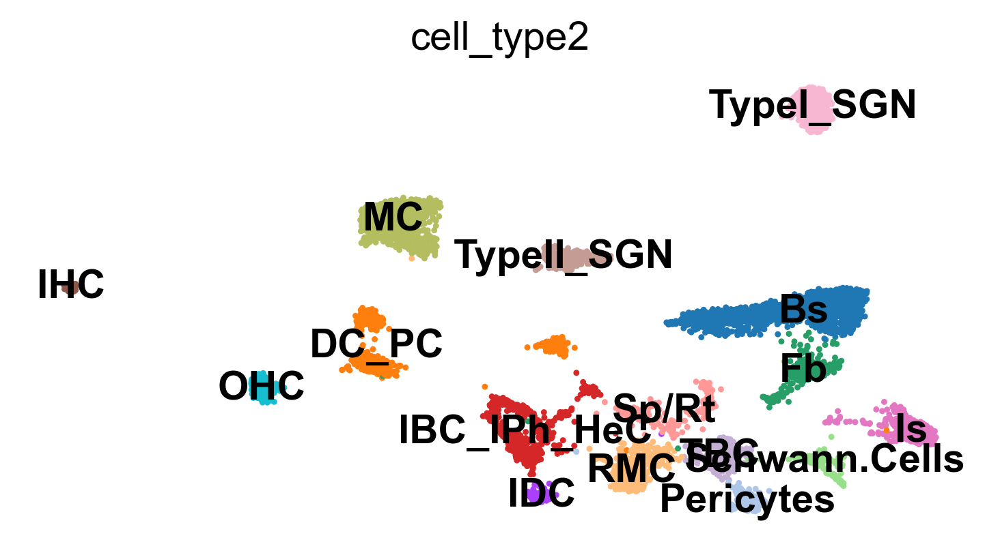

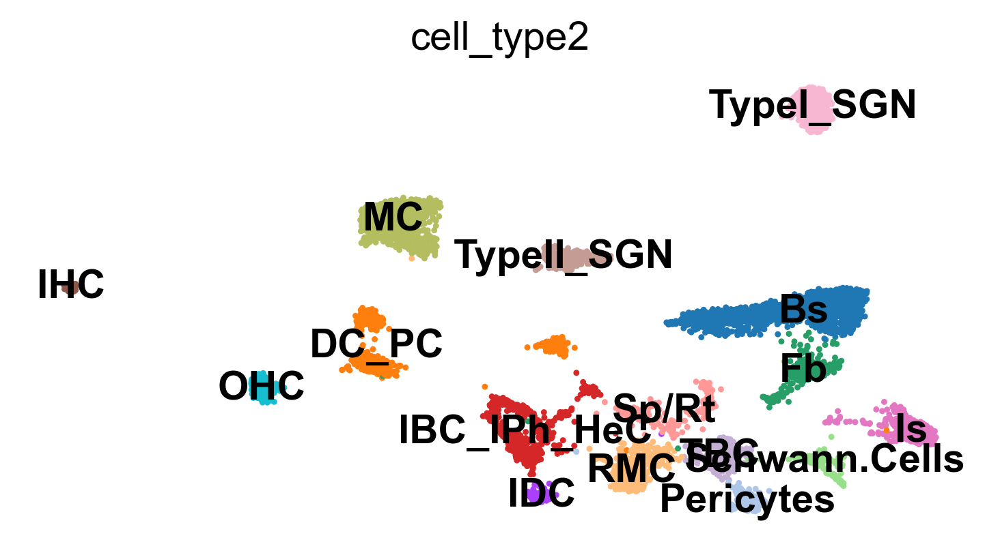

In [103]:
sc.pl.umap(adata2_sub, color=['cell_type2'],legend_loc="on data")
sc.pl.umap(adata2_raw, color=['cell_type2'],legend_loc="on data")

In [104]:
adata1_raw.write("./new_p21/P21_NEO_SCANPY_raw.h5ad")

In [ ]:
adata2_raw.write("./new_p21/P21_CTR_SCANPY_raw.h5ad")